# Verify requirements (Make sure run in GPU runtime)

In [ ]:
!nvidia-smi -L
!nvcc --version
!cmake --version

GPU 0: Tesla T4 (UUID: GPU-4660d78a-ce2e-a1b8-aae9-cb1355d6f618)
nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
cmake version 3.22.5

CMake suite maintained and supported by Kitware (kitware.com/cmake).


# Install OpenPose

In [ ]:
import os
from os.path import exists, join, basename, splitext

git_repo_url = 'https://github.com/CMU-Perceptual-Computing-Lab/openpose.git'
project_name = splitext(basename(git_repo_url))[0]
if not exists(project_name):
  # clone openpose
  !git clone -q --depth 1 $git_repo_url
  !sed -i 's/execute_process(COMMAND git checkout master WORKING_DIRECTORY ${CMAKE_SOURCE_DIR}\/3rdparty\/caffe)/execute_process(COMMAND git checkout f019d0dfe86f49d1140961f8c7dec22130c83154 WORKING_DIRECTORY ${CMAKE_SOURCE_DIR}\/3rdparty\/caffe)/g' openpose/CMakeLists.txt
  # install system dependencies
  !apt-get -qq install -y libatlas-base-dev libprotobuf-dev libleveldb-dev libsnappy-dev libhdf5-serial-dev protobuf-compiler libgflags-dev libgoogle-glog-dev liblmdb-dev opencl-headers ocl-icd-opencl-dev libviennacl-dev
  # install python dependencies
  !pip install -q youtube-dl
  # build openpose
  !cd openpose && rm -rf build || true && mkdir build && cd build && cmake -DBUILD_PYTHON=ON .. && make -j`nproc`

!mkdir openpose/videos && mkdir openpose/images && mkdir openpose/data

mkdir: cannot create directory ‘openpose/videos’: File exists


# Upload Your Video Here

In [ ]:
# direct to openpose
%cd openpose

/content/openpose


In [ ]:
import os 

# Define Openpose directory destination
OpenposeDir = '/content/openpose/'

# Upload Function
def upload_videos():
  from google.colab import files
  uploaded = files.upload()
  output = []
  for k, v in uploaded.items():
    open(k, 'wb').write(v)
    src = os.path.join(OpenposeDir,k)
    destination = os.path.join(OpenposeDir,'videos',k)
    os.rename(src,destination)
    output.append(destination)
  return output

videos_list = upload_videos()
videos_list

Saving slow.mp4 to slow.mp4


['/content/openpose/videos/slow.mp4']

# Import Libraries

In [ ]:
# import dependencies
from base64 import b64decode, b64encode
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import PIL
import io
import matplotlib.pyplot as plt

# Import Openpose dependencies
import sys
# Set Openpose Directory for python api
pyopenpose_dir = os.path.join(OpenposeDir,'build','python')
if pyopenpose_dir not in sys.path:
    sys.path.append(pyopenpose_dir)
from openpose import pyopenpose as op

# Main Program

## OpenPose Keypoints Reference

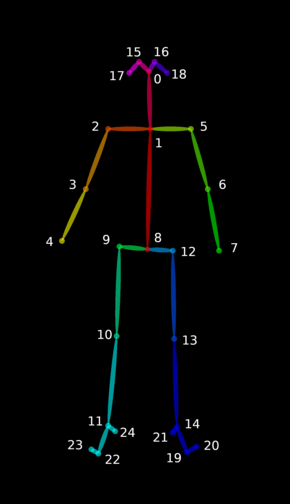



## Angles Calculation Function

In [ ]:
def calculateFlexionAngle(a, b, c):
    ba = a - b
    bc = c - b
    cosine_angle = np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc))
    angle = np.arccos(cosine_angle)
    return np.degrees(angle)

def getLeftAnglesFromDatum(datum):
    # joint declaration
    L_sternumX, L_sternumY, _ = datum.poseKeypoints[0][1]
    L_shoulderX, L_shoulderY, _ = datum.poseKeypoints[0][5]
    L_hipX, L_hipY, _ = datum.poseKeypoints[0][12]
    L_kneeX, L_kneeY, _ = datum.poseKeypoints[0][13]
    L_ankleX, L_ankleY, _ = datum.poseKeypoints[0][14]
    L_toeX, L_toeY, _ = datum.poseKeypoints[0][19]
    L_pinkyToeX, L_pinkyToeY, _ = datum.poseKeypoints[0][20]
    L_heelX, L_heelY, _ = datum.poseKeypoints[0][21]

    # left knee angle
    L_kneeAngle = 180 - calculateFlexionAngle(np.array([L_hipX, L_hipY]), 
                                              np.array([L_kneeX, L_kneeY]), 
                                              np.array([L_ankleX, L_ankleY]))
    L_kneeCoord = np.array([int(L_kneeX), int(L_kneeY)])

    # left hip angle
    L_hipAngle = 180 - calculateFlexionAngle(np.array([L_shoulderX, L_shoulderY]), 
                                             np.array([L_hipX, L_hipY]), 
                                             np.array([L_kneeX, L_kneeY]))
    L_hipCoord = np.array([int(L_hipX), int(L_hipY)])

    # get toe to pinky toe mid point
    L_midToeX = (L_toeX + L_pinkyToeX)/2
    L_midToeY = (L_toeY + L_pinkyToeY)/2

    # left ankle angle
    knee_ankle_toe = calculateFlexionAngle(np.array([L_kneeX, L_kneeY]),
                                           np.array([L_ankleX, L_ankleY]),
                                           np.array([L_toeX, L_ankleY]))
    L_ankleAngle = 90 - knee_ankle_toe
    L_ankleCoord = np.array([int(L_ankleX), int(L_ankleY)])

    return L_kneeAngle, L_kneeCoord, L_hipAngle, L_hipCoord, L_ankleAngle, L_ankleCoord

## Function to get joint coordinates

In [ ]:
joint_name = ['Nose', 'Neck', 'RShoulder', 'RElbow', 'RWrist', 'LShoulder', 'LElbow', 'LWrist', 'MidHip', 
              'RHip', 'RKnee', 'RAnkle', 'LHip', 'LKnee', 'LAnkle', 'REye', 'LEye', 'REar', 'LEar', 
              'LBigToe', 'LSmallToe', 'LHeel', 'RBigToe', 'RSmallToe', 'RHeel']

def getJointCoordinates(datum):
  # pt_0_x, pt_0_y, _ = datum.poseKeypoints[0][0]
  joint_coord = {}
  for i in range(0, 25):
    if i == 17:
      continue
    elif i == 18:
      continue
    elif i == 3:
      continue
    elif i == 4:
      continue
    elif i == 6:
      continue
    elif i == 7:
      continue
    else:
      ptX, ptY, _ = datum.poseKeypoints[0][i]
      joint_coord[i] = {
          "joints": joint_name[i],
          "x_coordinate": float(ptX),
          "y_coordinate": float(ptY)
      }
  return joint_coord

## Estimate Pose and Write in Video

In [ ]:
import time

# left
LKnee = []
LHip = []
LAnkle = []

# store time
time_series = []

joints = {}


def detectPose():
  # Custom Params
  params = dict()
  params["model_folder"] = os.path.join(OpenposeDir,'models')

  # Starting OpenPose
  opWrapper = op.WrapperPython()
  opWrapper.configure(params)
  opWrapper.start()

  # Video Read
  cap = cv2.VideoCapture(videos_list[0])

  # Default resolutions of the frame are obtained.The default resolutions are system dependent.
  # We convert the resolutions from float to integer.
  fps = cap.get(cv2.CAP_PROP_FPS)
  count = 0

  frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
  frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

  # Define the codec and create VideoWriter object
  fourcc = cv2.VideoWriter_fourcc(*'MP4V')
  out = cv2.VideoWriter(os.path.join(OpenposeDir,'videos','output.mp4'), fourcc, fps, (frame_width,  frame_height))


  counter = 0
  while cap.isOpened():
      # Read Image Frame
      ret, frame = cap.read()
      count += 1
      if ret:
          # Process Image
          datum = op.Datum()
          input_image = frame
          datum.cvInputData = input_image
          opWrapper.emplaceAndPop(op.VectorDatum([datum]))

          try:
              # Get joint coordinates
              joint_coord = getJointCoordinates(datum)
              joints[counter] = joint_coord

              # Get left-side joints
              L_kneeAngle, L_kneeCoord, L_hipAngle, L_hipCoord, L_ankleAngle, L_ankleCoord = getLeftAnglesFromDatum(datum)

              input_image = datum.cvOutputData

              # append list
              LKnee.append(L_kneeAngle)
              LHip.append(L_hipAngle)
              LAnkle.append(L_ankleAngle)

              cv2.putText(input_image, 'Time: ' + str(count/fps), (50, 50), cv2.FONT_HERSHEY_COMPLEX, 0.8, (102, 255, 0), 1)

              # show angles
              # left
              cv2.putText(input_image, 'LKnee: ' + str(L_kneeAngle) + ' deg',
                  (L_kneeCoord[0], L_kneeCoord[1]), cv2.FONT_HERSHEY_COMPLEX, 2, (102, 255, 0), 1)
              
              cv2.putText(input_image, 'LHip: ' + str(L_hipAngle) + ' deg',
                  (L_hipCoord[0], L_hipCoord[1]), cv2.FONT_HERSHEY_COMPLEX, 2, (102, 255, 0), 1)
              
              cv2.putText(input_image, 'LAnkle: ' + str(L_ankleAngle) + ' deg',
                  (L_ankleCoord[0], L_ankleCoord[1]), cv2.FONT_HERSHEY_COMPLEX, 2, (102, 255, 0), 1)

              # cv2.putText(input_image, 'LKnee: ' + str(L_kneeAngle) + ' deg',
              #     (50, 150), cv2.FONT_HERSHEY_COMPLEX, 2, (102, 255, 0), 1)
              
              # cv2.putText(input_image, 'LHip: ' + str(L_hipAngle) + ' deg',
              #     (50, 250), cv2.FONT_HERSHEY_COMPLEX, 2, (102, 255, 0), 1)
              
              # cv2.putText(input_image, 'LAnkle: ' + str(L_ankleAngle) + ' deg',
              #     (50, 350), cv2.FONT_HERSHEY_COMPLEX, 2, (102, 255, 0), 1)
              
              # Write Video Frame
              out.write(input_image)

              time_series.append(count/fps)

              counter += 1

          except Exception as e:
              # Catch Error
              print("Frame Extracting Error")
              print(e)
              break        
      else:
          # Break when finished
          print("Frame Extracting Finished")
          break

  # When everything done, release the video capture and video write objects
  cap.release()
  out.release()

if __name__ == '__main__':
  detectPose()

Frame Extracting Finished


# Preview Estimated Pose Video

In [ ]:
def showVideo(file_name):
  import io
  import base64
  from IPython.display import HTML

  video_path = os.path.join(OpenposeDir,'videos','output.mp4')

  # compress
  compressed_path = os.path.join(OpenposeDir,'videos','compressed_output.mp4')
  os.system(f"ffmpeg -i {video_path} -vcodec libx264 {compressed_path}")

  # Show video
  mp4 = open(compressed_path,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  return HTML("""
  <video width=400 controls>
        <source src="%s" type="video/mp4">
  </video>
  """ % data_url)

showVideo(os.path.join(OpenposeDir,'videos','compressed_output.mp4'))

# Export joint angles for analysis

In [ ]:
%cd data

/content/openpose/data


In [ ]:
import pandas as pd
import scipy.signal
from scipy.signal import savgol_filter

LKnee = np.array(LKnee)
time_series = np.array(time_series)

df = pd.DataFrame(list(zip(time_series, LAnkle, LKnee, LHip)), columns = ['Time', 'Left_Ankle', 'Left_Knee', 'Left_Hip'])
df.to_csv('joint_angles.csv')

# Export Joint Coordinates (For 3D only)

In [ ]:
joint_label = [0,1,2,5,8,9,10,11,12,13,14,15,16,19,20,21,22,23,24]

for i in range(len(joints)):
  print(f'-----------Frame_{i}--------------')
  for j in joint_label:
    print(f'joint: {joints[i][j]["joints"]} ---> x: {joints[i][j]["x_coordinate"]}, y: {joints[i][j]["y_coordinate"]}')

Streaming output truncated to the last 5000 lines.
-----------Frame_343--------------
joint: Nose ---> x: 1301.135498046875, y: 1259.115966796875
joint: Neck ---> x: 1144.02685546875, y: 1563.4771728515625
joint: RShoulder ---> x: 965.8671875, y: 1563.2779541015625
joint: LShoulder ---> x: 1374.538818359375, y: 1563.520263671875
joint: MidHip ---> x: 955.259033203125, y: 2329.0244140625
joint: RHip ---> x: 797.9854125976562, y: 2318.77783203125
joint: RKnee ---> x: 1039.264404296875, y: 2801.170654296875
joint: RAnkle ---> x: 871.2783813476562, y: 3357.06640625
joint: LHip ---> x: 1112.3125, y: 2318.85986328125
joint: LKnee ---> x: 1468.5880126953125, y: 2717.059326171875
joint: LAnkle ---> x: 1175.3031005859375, y: 3221.09521484375
joint: REye ---> x: 1228.1080322265625, y: 1206.5146484375
joint: LEye ---> x: 1311.8184814453125, y: 1207.002197265625
joint: LBigToe ---> x: 1395.6871337890625, y: 3346.470703125
joint: LSmallToe ---> x: 1385.1771240234375, y: 3314.91552734375
joint: LHee

In [ ]:
import json

In [ ]:
with open("joints.json", "w") as outfile:
    json.dump(joints, outfile)

## For 3D Uses Only

In [ ]:
def returnCoord(pt):
  return pt

In [ ]:
with open('joints.json') as json_file:
    joints_json = json.load(json_file)

In [ ]:
frames_no = []
for f in range(len(joints_json)):
  coord = []
  for i in joint_label:
    x, y = joints_json[str(f)][str(i)]["x_coordinate"], joints_json[str(f)][str(i)]["y_coordinate"]
    coord.append([x, y])
  frames_no.append(coord)

In [ ]:
returned = []

for f in range(len(joints_json)):
  coord = frames_no[f]
  coord = np.array(coord)
  
  pt_rt = returnCoord(coord)
  returned.append(pt_rt)

In [ ]:
returned = np.array(returned)

In [ ]:
len(returned)

593

In [ ]:
%cd images

/content/openpose/images


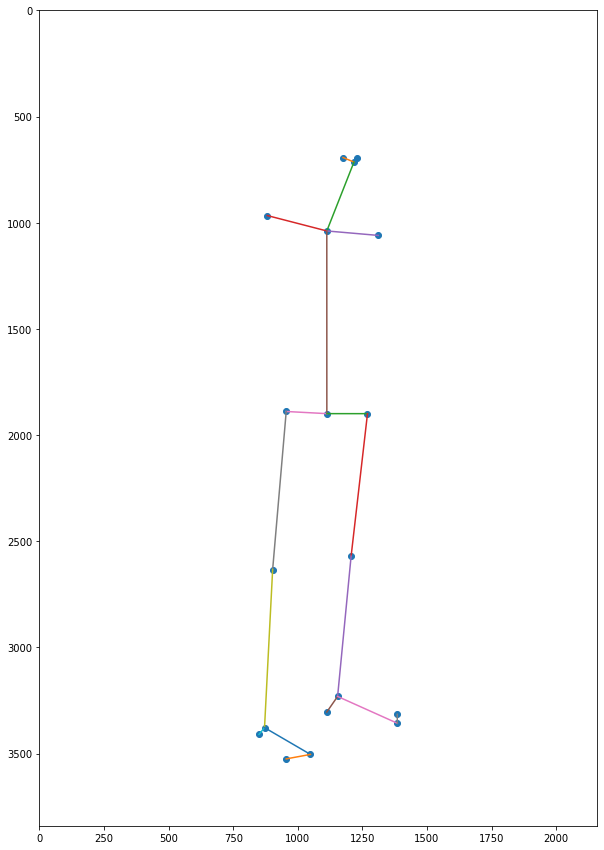

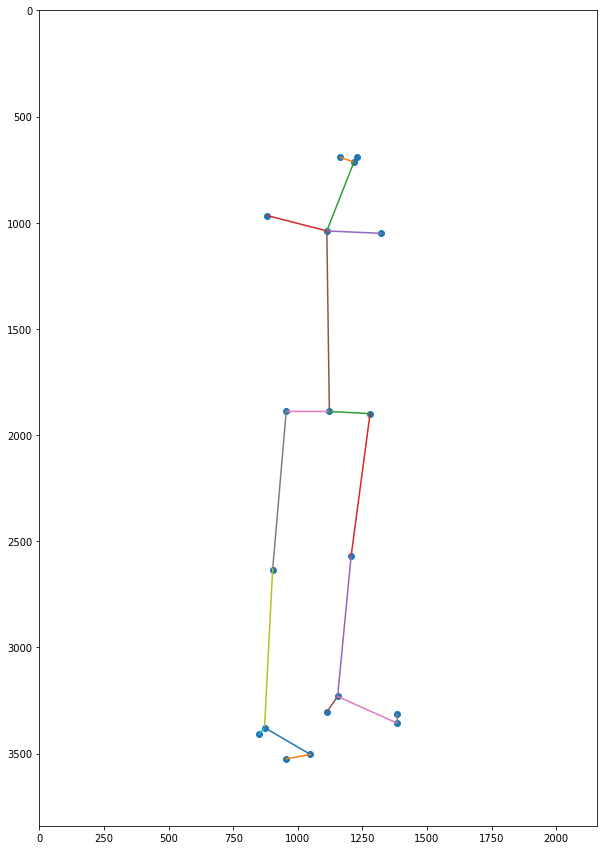

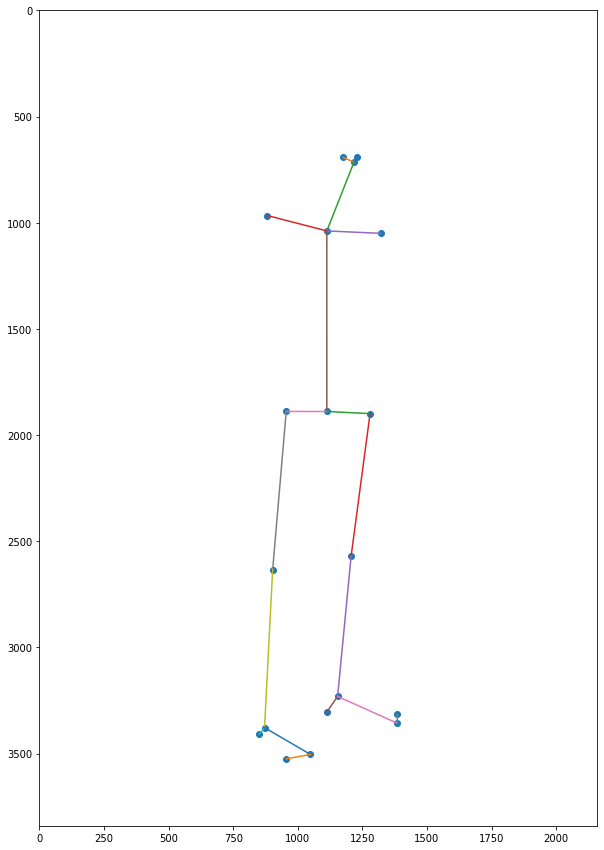

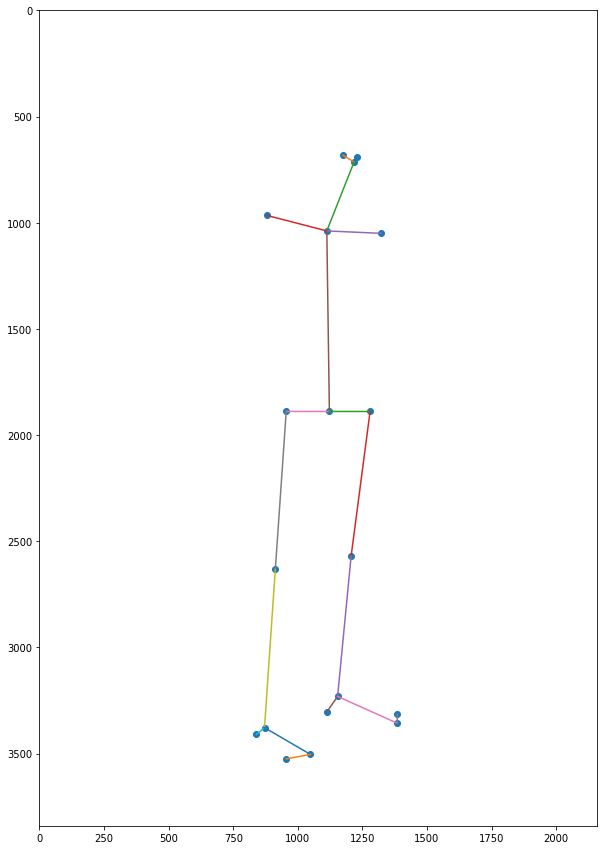

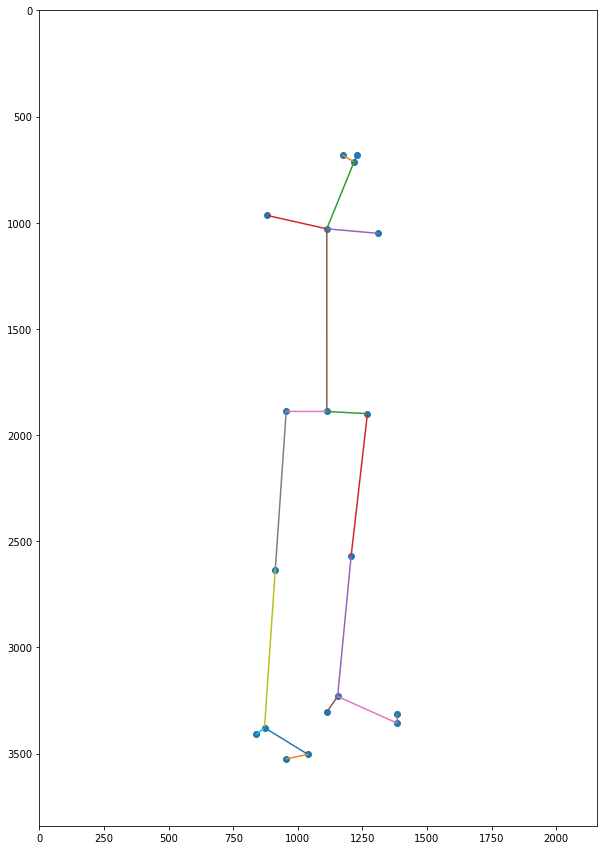

...

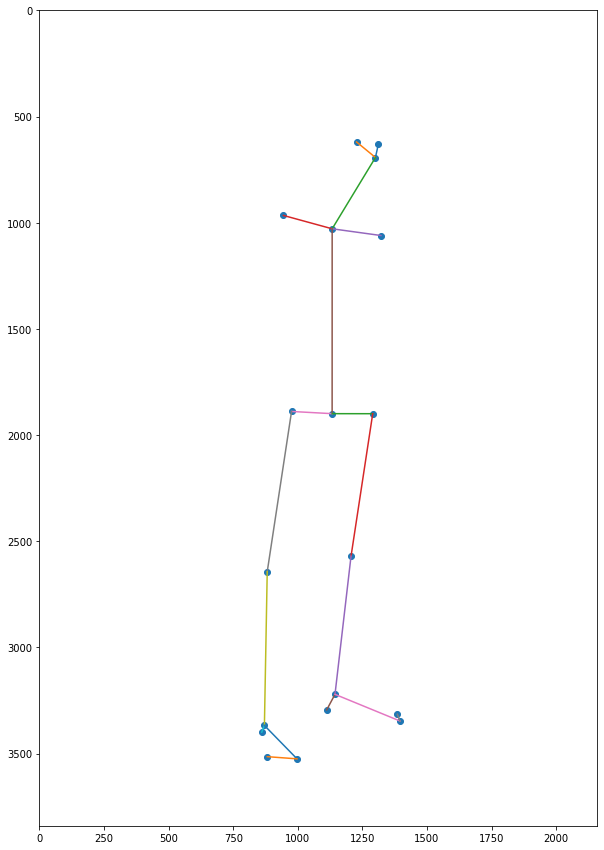

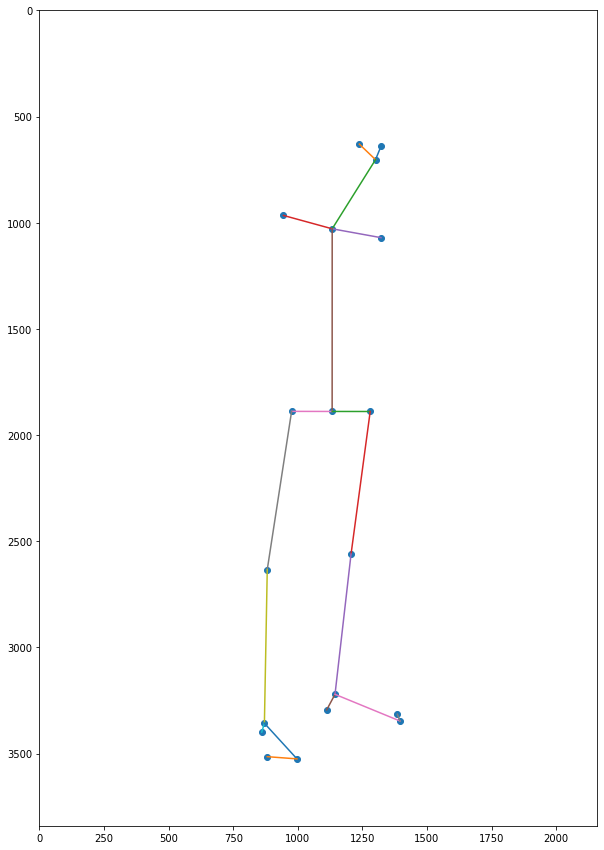

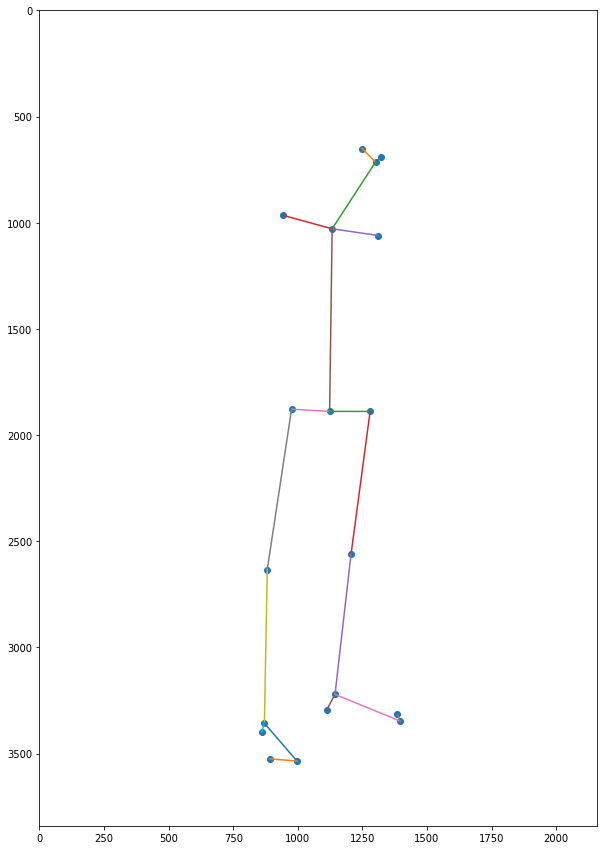

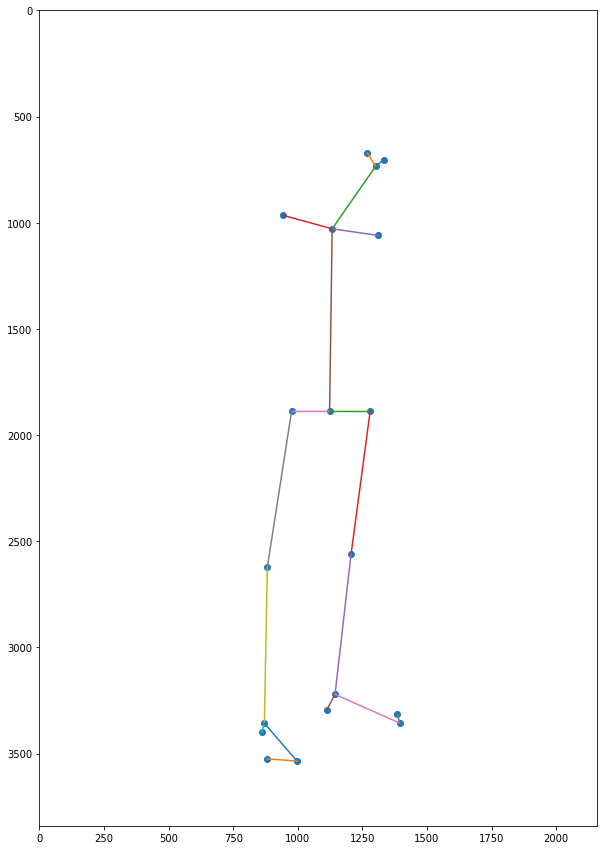

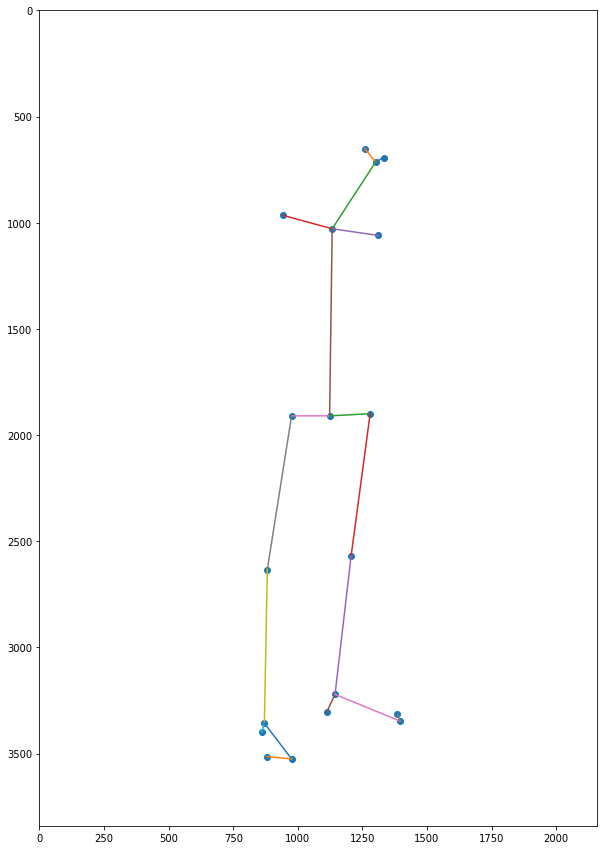

In [ ]:
conn = [[0,12], [0,11], [0,1], [1,2], [1,3], [1,4], [4,5], [5,6], [6,7], [7,18], [7,16], [16,17], [4,8], [8,9], [9,10], [10,15], [10,13], [13,14]]

for i in range(len(returned)):
  fig = plt.figure(figsize=(10,15))
  plt.xlim([0, 2160])
  plt.ylim([0, 3840])
  plt.gca().invert_yaxis()
  plt.scatter(returned[i][:,0], returned[i][:,1])
  for c in conn:
    plt.plot([returned[i][c[0],0], returned[i][c[1],0]], [returned[i][c[0],1], returned[i][c[1],1]])
  plt.savefig('frame' + str(i) + '.jpg')

  plt.show()